As a consultant for Olist (online solution for marketplaces),
we are commissioned to segment their client database. <br>
The goal is to establish a base for their communication campaigns. <br> 
They also require a maintenance contract based on a stability analysis of the different segments over time.

pd.show_versions() <br>
pandas version : 1.0.5 <br>
numpy version : 1.18.5 <br>
seaborn version : 0.11.2 <br>
matplotlib version : 3.2.2 <br>

This is the tryout notebook where I put to the test different clustering algorithms <br>
- : Usual loadings <br>
Part - 1 <a href='#simple'> Simple models <br>
$\;\;\;\;\;\;$ <a href='#pareto'> Pareto law <br>
$\;\;\;\;\;\;$ <a href='#abc'> ABC method <br>
$\;\;\;\;\;\;$ <a href='#hand'> RFM method <br>
$\;\;\;\;\;\;$ <a href='#Krfm'> Kmeans RFM <br>
    
Part 2 - KMeans with more parameters <br>
$\;\;\;\;\;\;$ <a href='#5means'> KMeans with 5 <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#elbo'> Elbow method </a> <br> 
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#davi'> David Bouldin method </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#silho'> Silhouette method </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#inter'> Intercluster Distance Maps </a> <br>
$\;\;\;\;\;\;$ <a href='#catmeans'> KMeans 5 with categories <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#nclus'> Best number of clusters </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pcav'> PCA vizualisation </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#cread'> Reading the cluster </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#extra'> Extra readings </a> <br>
$\;\;\;\;\;\;$ <a href='#full'> Full feature engineering with PCA <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pcafull'> Full features PCA <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pcafullnumb'> Best number of clusters <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pca15'> Kmeans_PCA 15 <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pca5'> Kmeans_PCA 7 <br>
    
Part - 3 Other Algorithmes <br>
$\;\;\;\;\;\;$ <a href='#agglo'> Agglomerative Hierarchical Clustering <br>
$\;\;\;\;\;\;$ <a href='#dbsc'> DBSCAN <br>

# Part 2 - KMeans with more parameters

Now we start to add up the feature engenineered

<a id='5means' />

## KMeans with 5

In [62]:
dorder.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,distance,geo_mlat_customer,geo_mlng_customer,seller_zip_code_prefix,seller_city,seller_state,geo_mlat_seller,geo_mlng_seller,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,Time_of_purchase,Time_of_purchase_sec,Number_of_orders,First_order_time,Last_order_time,Recency,Frequency,total_payment_value,tot_customer_spending,mean_review_score,order_delivered_time,order_estimated_delivery,delay_delivery,categories,Number_of_articles,mean_spending,Most_used_method_of_payment,Method_used_to_spend_the_most,MUM_of_payment_a,MU_to_spend_the_most_a,Preferred category,cool_stuff,pet_shop,home_confort,health_beauty,electronics,industry_commerce_construction,arts_video_audio,clothing_and_bags,auto,alpha_cats,Cus_mean_review_score
0,00010242fe8c5a6d1ba2dd792cb16214,1.0,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29,1.0,credit_card,2.0,72.19,97ca439bc427b48bc1cd7177abe71365,5.0,Unknown,"Perfeito, produto entregue antes do combinado.",2017-09-21 00:00:00,2017-09-22 10:57:03,3ce436f183e68e07877b285a838db11a,delivered,2017-09-13 08:59:02,2017-09-13 09:45:35,2017-09-19 18:34:16,2017-09-20 23:43:48,2017-09-29 00:00:00,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,2.945252,-21.762775,-41.309633,27277.0,volta redonda,SP,-22.496953,-44.127492,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,cool_stuff,621.290995,53679542.0,1,53679542,53679542,355.005498,1.0,72.19,72.19,5.0,628.905417,636.916667,8.011250,cool_stuff,1,72.19,credit_card,credit_card,1,1,cool_stuff,1,0,0,0,0,0,0,0,0,1,5.0
1,130898c0987d1801452a8ed92a670612,1.0,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-07-05 02:44:11,55.9,17.96,1.0,boleto,1.0,73.86,b11cba360bbe71410c291b764753d37f,5.0,Unknown,"lannister como sempre, entregou certinho e dentro do prazo. recomendo muito",2017-07-14 00:00:00,2017-07-17 12:50:07,e6eecc5a77de221464d1c4eaff0a9b64,delivered,2017-06-28 11:52:20,2017-06-29 02:44:11,2017-07-05 12:00:33,2017-07-13 20:39:29,2017-07-26 00:00:00,0fb8e3eab2d3e79d92bb3fffbb97f188,75800,jatai,GO,7.887528,-17.884337,-51.716990,27277.0,volta redonda,SP,-22.496953,-44.127492,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,cool_stuff,544.411343,47037140.0,1,47037140,47037140,431.885150,1.0,73.86,73.86,5.0,559.777419,571.916667,12.139248,cool_stuff,1,73.86,boleto,boleto,2,2,cool_stuff,1,0,0,0,0,0,0,0,0,1,5.0
2,532ed5e14e24ae1f0d735b91524b98b9,1.0,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2018-05-23 10:56:25,64.9,18.33,1.0,credit_card,2.0,83.23,af01c4017c5ab46df6cc810e069e654a,4.0,super recomendo,carrinho muito bonito,2018-06-05 00:00:00,2018-06-06 21:41:12,4ef55bf80f711b372afebcb7c715344a,delivered,2018-05-18 10:25:53,2018-05-18 12:31:43,2018-05-23 14:05:00,2018-06-04 18:34:26,2018-06-07 00:00:00,3419052c8c6b45daf79c1e426f9e9bcb,30720,belo horizonte,MG,1.614209,-19.914323,-43.975703,27277.0,volta redonda,SP,-22.496953,-44.127492,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,cool_stuff,868.351308,75025553.0,1,75025553,75025553,107.945185,1.0,83.23,83.23,4.0,885.690579,887.916667,2.226088,cool_stuff,1,83.23,credit_card,credit_card,1,1,cool_stuff,1,0,0,0,0,0,0,0,0,1,4.0
3,6f8c31653edb8c83e1a739408b5ff750,1.0,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-08-07 18:55:08,58.9,16.17,1.0,credit_card,3.0,75.07,8304ff37d8b16b57086fa283fe0c44f8,5.

In [63]:
dat.head(1)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,distance,geo_mlat_customer,geo_mlng_customer,seller_zip_code_prefix,seller_city,seller_state,geo_mlat_seller,geo_mlng_seller,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,Time_of_purchase,Time_of_purchase_sec,Number_of_orders,First_order_time,Last_order_time,Recency,Frequency,total_payment_value,tot_customer_spending,mean_review_score,order_delivered_time,order_estimated_delivery,delay_delivery,categories,Number_of_articles,mean_spending,Most_used_method_of_payment,Method_used_to_spend_the_most,MUM_of_payment_a,MU_to_spend_the_most_a,Preferred category,cool_stuff,pet_shop,home_confort,health_beauty,electronics,industry_commerce_construction,arts_video_audio,clothing_and_bags,auto,alpha_cats,Cus_mean_review_score
0,00010242fe8c5a6d1ba2dd792cb16214,1.0,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29,1.0,credit_card,2.0,72.19,97ca439bc427b48bc1cd7177abe71365,5.0,Unknown,"Perfeito, produto entregue antes do combinado.",2017-09-21 00:00:00,2017-09-22 10:57:03,3ce436f183e68e07877b285a838db11a,delivered,2017-09-13 08:59:02,2017-09-13 09:45:35,2017-09-19 18:34:16,2017-09-20 23:43:48,2017-09-29 00:00:00,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,2.945252,-21.762775,-41.309633,27277.0,volta redonda,SP,-22.496953,-44.127492,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,cool_stuff,621.290995,53679542.0,1,53679542,53679542,355.005498,1.0,72.19,72.19,5.0,628.905417,636.916667,8.01125,cool_stuff,1,72.19,credit_card,credit_card,1,1,cool_stuff,1,0,0,0,0,0,0,0,0,1,5.0


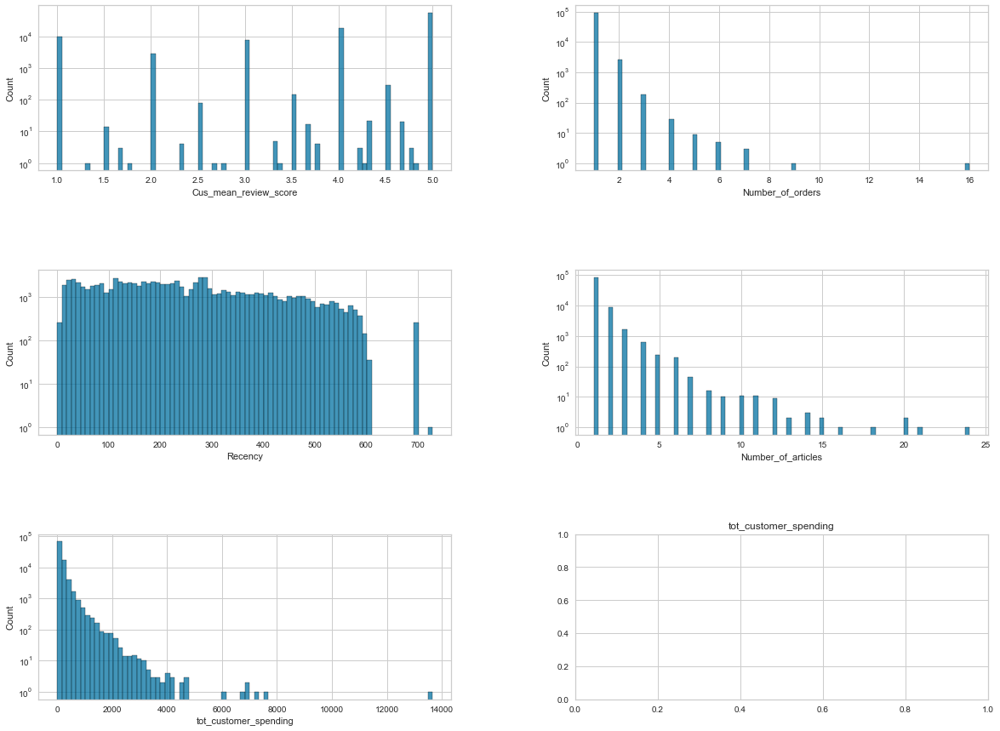

In [64]:
dfn = dat[['Cus_mean_review_score', 'Number_of_orders',
            'Recency', 'Number_of_articles', 'tot_customer_spending']]
dfnl = list(dfn)
dfnll = len(dfnl)
si = round(dfnll/1.9)

fig, axes = plt.subplots(ncols=2, nrows=si, figsize=(20, dfnll*3))
fig.subplots_adjust(wspace=0.3, hspace=0.6)

nbins = 80
    
for i, ax in zip(range(dfnll), axes.flat):

    sns.histplot(data=dfn[dfnl[i]].dropna(), kde=False, bins=nbins, log_scale=(False, True), ax=ax)
    plt.title(dfnl[i])

In [65]:
dfn.describe()

,Cus_mean_review_score,Number_of_orders,Recency,Number_of_articles,tot_customer_spending
count,93702.000000,94397.000000,94397.000000,94397.000000,94397.000000
mean,4.130954,1.033751,242.482212,1.179900,165.839932
std,1.300793,0.210544,152.705525,0.619634,227.608391
min,1.000000,1.000000,0.000000,1.000000,0.000000
25%,4.000000,1.000000,118.800613,1.000000,63.010000
50%,5.000000,1.000000,223.397083,1.000000,107.800000
75%,5.000000,1.000000,351.331644,1.000000,183.080000
max,5.000000,16.000000,728.494190,24.000000,13664.080000


In [20]:
dat['log_Spending'] = np.log1p(dat['tot_customer_spending'])

# Reloading after restart

In [67]:
fig = px.histogram(dat['log_Spending'],
            marginal="box",
            width=600,
            height=400
        )
fig.show()

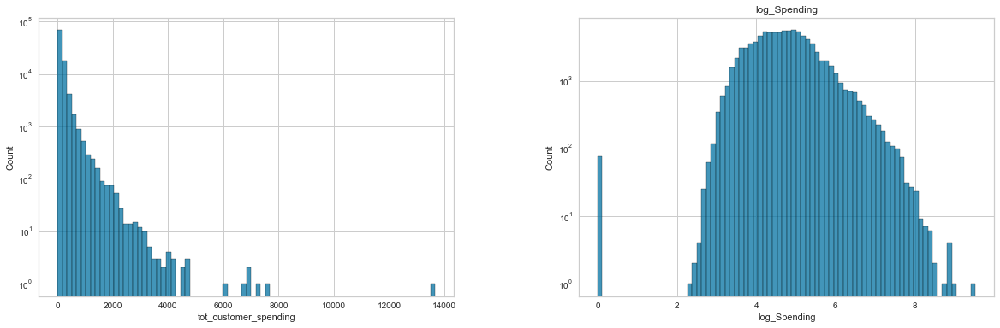

In [68]:
dfn = dat[['tot_customer_spending', 'log_Spending']]
dfnl = list(dfn)
dfnll = len(dfnl)
si = round(dfnll/1.9)

fig, axes = plt.subplots(ncols=2, nrows=si, figsize=(20, dfnll*3))
fig.subplots_adjust(wspace=0.3, hspace=0.6)

nbins = 80
    
for i, ax in zip(range(dfnll), axes.flat):

    sns.histplot(data=dfn[dfnl[i]].dropna(), kde=False, bins=nbins, log_scale=(False, True), ax=ax)
    plt.title(dfnl[i])

In [69]:
dat.head(1)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,distance,geo_mlat_customer,geo_mlng_customer,seller_zip_code_prefix,seller_city,seller_state,geo_mlat_seller,geo_mlng_seller,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,Time_of_purchase,Time_of_purchase_sec,Number_of_orders,First_order_time,Last_order_time,Recency,Frequency,total_payment_value,tot_customer_spending,mean_review_score,order_delivered_time,order_estimated_delivery,delay_delivery,categories,Number_of_articles,mean_spending,Most_used_method_of_payment,Method_used_to_spend_the_most,MUM_of_payment_a,MU_to_spend_the_most_a,Preferred category,cool_stuff,pet_shop,home_confort,health_beauty,electronics,industry_commerce_construction,arts_video_audio,clothing_and_bags,auto,alpha_cats,Cus_mean_review_score,log_Spending
0,00010242fe8c5a6d1ba2dd792cb16214,1.0,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29,1.0,credit_card,2.0,72.19,97ca439bc427b48bc1cd7177abe71365,5.0,Unknown,"Perfeito, produto entregue antes do combinado.",2017-09-21 00:00:00,2017-09-22 10:57:03,3ce436f183e68e07877b285a838db11a,delivered,2017-09-13 08:59:02,2017-09-13 09:45:35,2017-09-19 18:34:16,2017-09-20 23:43:48,2017-09-29 00:00:00,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,2.945252,-21.762775,-41.309633,27277.0,volta redonda,SP,-22.496953,-44.127492,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,cool_stuff,621.290995,53679542.0,1,53679542,53679542,355.005498,1.0,72.19,72.19,5.0,628.905417,636.916667,8.01125,cool_stuff,1,72.19,credit_card,credit_card,1,1,cool_stuff,1,0,0,0,0,0,0,0,0,1,5.0,4.293059


In [21]:
# Here, we pickup all the previous criteria
XKm = dat.copy()[['Cus_mean_review_score', 'Number_of_orders', 'Recency', 'Number_of_articles', 'log_Spending',
                  'categories', 'cool_stuff', 'pet_shop', 'home_confort', 'health_beauty', 'electronics',
                  'industry_commerce_construction', 'arts_video_audio', 'clothing_and_bags', 'auto', 'alpha_cats',
                  'tot_customer_spending', 'mean_spending', 'MUM_of_payment_a', 'MU_to_spend_the_most_a',
                  'delay_delivery', 'distance']]

# Reloading after restart

In [71]:
XKm.isna().mean()

Cus_mean_review_score             0.007363
Number_of_orders                  0.000000
Recency                           0.000000
Number_of_articles                0.000000
log_Spending                      0.000000
categories                        0.014344
cool_stuff                        0.000000
pet_shop                          0.000000
home_confort                      0.000000
health_beauty                     0.000000
electronics                       0.000000
industry_commerce_construction    0.000000
arts_video_audio                  0.000000
clothing_and_bags                 0.000000
auto                              0.000000
alpha_cats                        0.000000
tot_customer_spending             0.000000
mean_spending                     0.000000
MUM_of_payment_a                  0.000000
MU_to_spend_the_most_a            0.000000
delay_delivery                    0.011388
distance                          0.004915
dtype: float64

In [72]:
XKm.shape[0]*0.014344/100

13.540305680000001

In [23]:
XKm_nona = XKm.copy().dropna()

# Normalisation
selected = ['Cus_mean_review_score', 'Number_of_orders', 'Recency', 'Number_of_articles', 'log_Spending']
XKm_Norm = std_scale.fit_transform(XKm_nona[selected])

# Reloading after restart

<a id='nclus' />

## Best number of clusters

#### In this part, the goal is to find the best number of clusters using mathematical methods

<a id='elbo' />

### The elbow method (aka, inertia)

In [74]:
#### "Inertia" is the sum of squared distances of samples to their closest cluster center (doc sklearn)
#### The more clusters we have, the smallest the inertie will be

#### sommes des distances au ² des points par rapport à leur cluster le plus proches
#### plus on augmente le nombre de cluster (ie complexité de l'algo)
#### plus on devrait réduire cette valeur

In [75]:
# Best number of clusters
startt = time.time()

inertia = []
silhouette = []

K_range = range(2, 12)
for k in K_range:
    model = KMeans(n_clusters=k).fit(XKm_Norm)
    inertia.append(model.inertia_)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  11.263477802276611 sec


In [76]:
#### Elbow methode
#### We are looking for an elbow (i.e : clear inflection on the curve) which is a good 
#### indication that the underlying model fits best at that point

#### Méthode du coude
#### On recherche un coude pour déterminer le nombre de cluster idéal
#### méthode visuel potentiellement approximative

Text(0, 0.5, 'Cout du modèle (Inertia)')

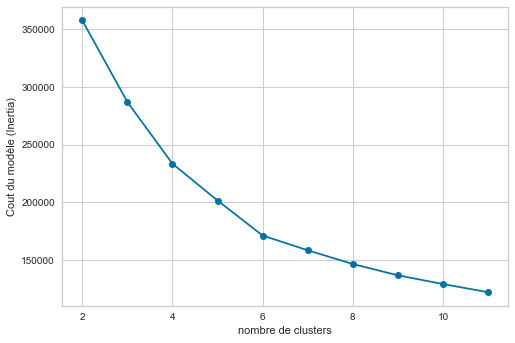

In [77]:
# Mettre un titre sur le graph et gérer les tailles des polices / plotly ? seaborn ?
plt.plot(K_range, inertia, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('Cout du modèle (Inertia)')

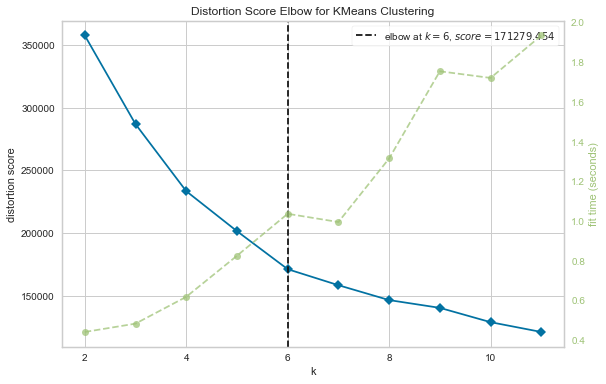

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [78]:
plt.rcParams["figure.figsize"] = (9,6)

# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,12))

visualizer.fit(XKm_Norm)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

<a id='davi' />

### Davies Bouldin method

#### A lower level of the Davies_Bouldin index relates to a model with better separation between the clusters

https://scikit-learn.org/stable/modules/clustering.html#davies-bouldin-index
The index signifies the average 'similarity' between clusters, where the similarity is a measure that compares the distance between clusters with the size of the clusters themselves.

In [79]:
# Best number of clusters with davies
startt = time.time()

davies_ad = []

K_range = range(2, 12)
for k in K_range:
    
    cls_ad = cluster.KMeans(n_clusters=k)
    cls_ad.fit(XKm_Norm)
    dav_ad = metrics.davies_bouldin_score(XKm_Norm, cls_ad.labels_)
    davies_ad.append(dav_ad)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  11.535025358200073 sec


Text(0, 0.5, 'davies_bouldin')

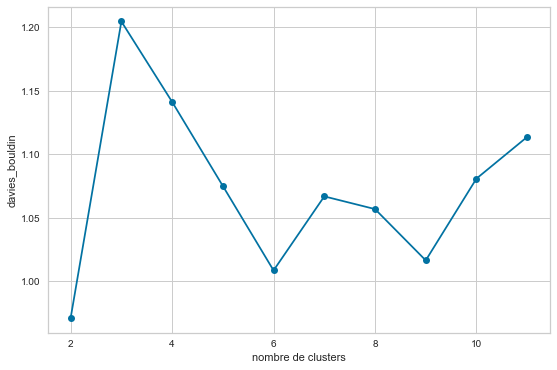

In [80]:
# Mettre un titre sur le graph et gérer les tailles des polices / plotly ? seaborn ?
plt.plot(K_range, davies_ad, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('davies_bouldin')

<a id='silho' />

### Silhouette method

In [81]:
# Best number of clusters
startt = time.time()

inertia = []
silhouette = []

K_range = range(2, 12)
for k in K_range:
    
    cls = cluster.KMeans(n_clusters=k)
    cls.fit(XKm_Norm)
    silh = metrics.silhouette_score(XKm_Norm, cls.labels_)
    silhouette.append(silh)
    
    print(k)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

2
3
4
5
6
7
8
9
10
11
total time:  713.8824570178986 sec


Text(0, 0.5, 'silhoutte')

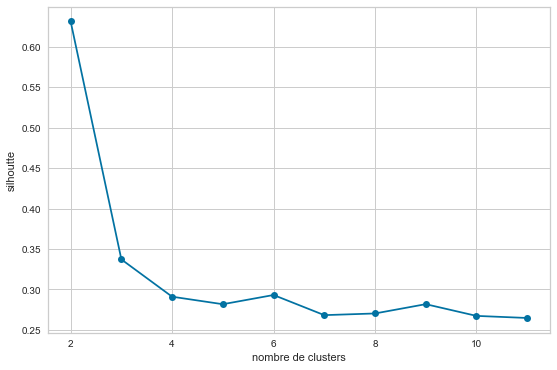

In [82]:
plt.plot(K_range, silhouette, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('silhoutte')

#### The silhouette coeff shows that the best number of clusters is (most of the time) 6. We don't take into consideration the clusters with lower number than 4 since it is not actionnable for the marketing team

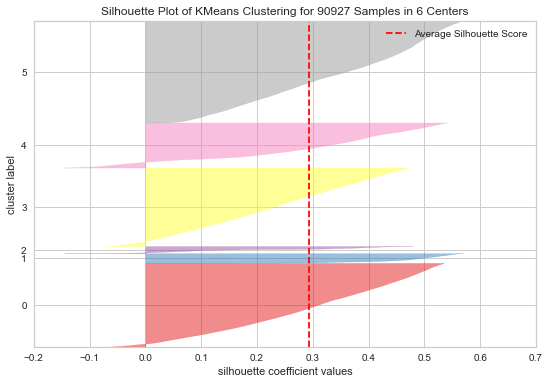

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 90927 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [83]:
# Instantiate the clustering model and visualizer 
model = KMeans(6)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(XKm_Norm)    # Fit the data to the visualizer
visualizer.poof()

<a id='inter' />

### Intercluster Distance Maps

Intercluster distance maps display an embedding of the cluster centers in 2 dimensions with the distance to other centers preserved. E.g. the closer to centers are in the visualization, the closer they are in the original feature space.

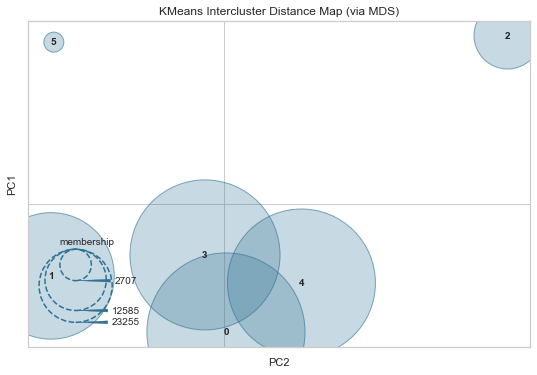

<AxesSubplot:title={'center':'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [84]:
# Instantiate the clustering model and visualizer
model = KMeans(6)
visualizer = InterclusterDistance(model)

visualizer.fit(XKm_Norm)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

<a id='pcav' />

### PCA vizualisation

In [85]:
pca = decomposition.PCA(n_components=4)
pca.fit(XKm_Norm)
print(pca.explained_variance_ratio_.cumsum())
X_trans = pca.transform(XKm_Norm)

[0.32236765 0.52553541 0.72326193 0.89324088]


In [201]:
cls6 = cluster.KMeans(n_clusters=6)
cls6.fit(XKm_Norm)
px.scatter_3d(x=X_trans[:, 0], y=X_trans[:, 1], z=X_trans[:, 2], color=cls6.labels_)

<a id='cread' />

## Reading the clusters

In [88]:
model = KMeans(n_clusters=6)
model.fit(XKm_Norm)
model.labels_

array([1, 1, 2, ..., 5, 1, 2])

In [89]:
XKm_nona['cluster'] = model.labels_

In [90]:
X_trans = (model.transform(XKm_Norm))

In [91]:
X_trans.shape

(90927, 6)

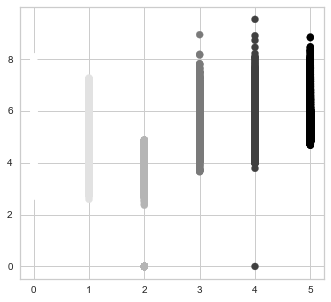

In [92]:
fig = plt.figure(figsize=(12,5))

ax = fig.add_subplot(121)
ax.scatter(model.labels_, XKm_nona['log_Spending']  , c=model.labels_)

<a id='clus' />

### Clusters

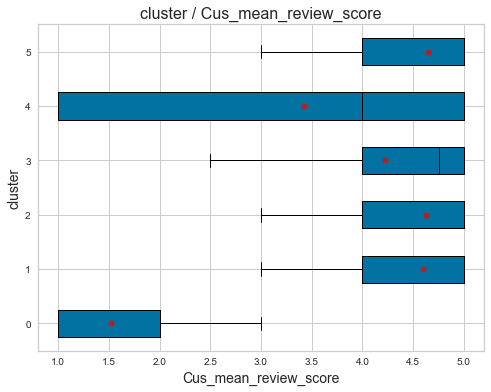

                    sum_sq       df             F  PR(>F)
C(catquali)  105015.002205      5.0  43786.337027     0.0
Residual      43612.093012  90921.0           NaN     NaN


In [95]:
boxplots(XKm_nona, 'cluster', 'Cus_mean_review_score', tukey=0, size=(8,6), showfliers=False, sort = 1)

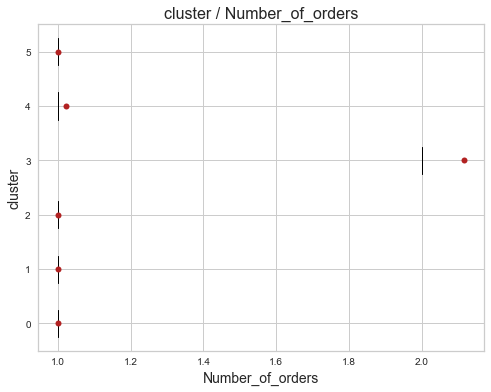

                  sum_sq       df             F  PR(>F)
C(catquali)  3273.395953      5.0  76012.237352     0.0
Residual      783.085576  90921.0           NaN     NaN


In [96]:
boxplots(XKm_nona, 'cluster', 'Number_of_orders', tukey=0, size=(8,6), showfliers=False, sort = 1)

In [97]:
clusters_uniq = XKm_nona['cluster'].unique()
mean_Number_of_orders = []
# selected = selected categories

for i in range(len(clusters_uniq)) :
    means_c = []
    Mean_cluster = XKm_nona[XKm_nona['cluster'].isin([clusters_uniq[i]])]
    for y in range(len(selected)) :
        a = Mean_cluster[selected[y]]
        norma = ((a - min(a)) / (max(a) - min(a)))
        norma = a / max(a)
        meana = norma.mean()
        means_c.append(norma.mean())
        
    print('cluster ', i)
    
    df = pd.DataFrame(dict(
        r=means_c,
        theta=selected))
    

    fig = px.line_polar(df, r='r', theta='theta', line_close=True)
    fig.show()

cluster  0


cluster  1


cluster  2


cluster  3


cluster  4


cluster  5


In [98]:
import plotly.graph_objects as go
fig = go.Figure()

clusters_uniq = XKm_nona['cluster'].unique()
names = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4', 'cluster 5',]
mean_Number_of_orders = []
# selected = selected categories

for i in range(len(clusters_uniq)) :
    means_c = []
    Mean_cluster = XKm_nona[XKm_nona['cluster'].isin([clusters_uniq[i]])]
    for y in range(len(selected)) :
        a = Mean_cluster[selected[y]]
        norma = ((a - min(a)) / (max(a) - min(a)))
        norma = a / max(a)
        meana = norma.mean()
        means_c.append(norma.mean())
    
    fig.add_trace(go.Scatterpolar(r=means_c, theta=selected, fill='toself', name=names[i]))
    
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, 1]
    )),
  showlegend=True
)
fig.show()

In [99]:
# clusters_uniq = XKm_nona['cluster'].unique()
# names = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4', 'cluster 5']
# Cluster_means = []
# # selected = selected categories

# for i in range(len(clusters_uniq)) :
#     means_c = []
#     Mean_cluster = XKm_nona[XKm_nona['cluster'].isin([clusters_uniq[i]])]
#     for y in range(len(selected)) :
#         a = Mean_cluster[selected[y]]
#         norma = ((a - min(a)) / (max(a) - min(a)))
#         norma = a / max(a)
#         meana = norma.mean()
#         means_c.append(meana)
#     means_c.append(i)
#     Cluster_means.append(means_c)

# col_names = selected.copy()
# col_names.append('cluster')
# df = pd.DataFrame(Cluster_means, columns = col_names)

# fig = px.parallel_coordinates(df, color='cluster', labels={"Mean review score": "Cus_mean_review_scores",
#                 "Number of orders": "Number_of_orders", "Last order in days": "Recency",
#                 "Total bought articles": "Number_of_articles", "Total spending": "log_Spending", },
#                              color_continuous_scale=px.colors.diverging.Tealrose,
#                              color_continuous_midpoint=2)
# fig.show()

In [100]:
clusters_uniq = XKm_nona['cluster'].unique()
#cluster_names = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4', 'cluster 5']
#cluster_names = ['black', 'blanchedalmond', 'blue','blueviolet', 'brown', 'burlywood', 'cadetblue']

Cluster_means = []
# selected = selected categories

for i in range(len(clusters_uniq)) :
    means_c = []
    Mean_cluster = XKm_nona[XKm_nona['cluster'].isin([clusters_uniq[i]])]
    for y in range(len(selected)) :
        a = Mean_cluster[selected[y]]
        means_c.append(a.mean())
    means_c.append(i)
    Cluster_means.append(means_c)

col_names = selected.copy()
col_names.append('cluster')

df = pd.DataFrame(Cluster_means, columns = col_names)

fig = px.parallel_coordinates(df, color='cluster', labels={"Cus_mean_review_score" : "Mean review score",
                                                           "Number_of_orders": "Number of orders",
                                                           "Recency" : "Last order in days", 
                                                           "Number_of_articles": "Total bought articles",
                                                           "log_Spending": "Total spending (log)"},
                              title = 'Mean values of the clusters',
                              dimensions = selected,
                              #color_continuous_scale=px.colors.diverging.Tealrose,
                              #color_continuous_scale=('red', 'blue', 'green', 'red', 'blue', 'green'),
                              #color_continuous_midpoint=2)
                              range_color = (1,6)
                             )
fig.show()

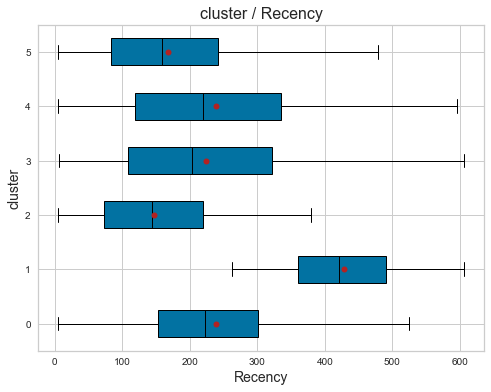

                   sum_sq       df             F  PR(>F)
C(catquali)  1.189115e+09      5.0  23270.619071     0.0
Residual     9.292021e+08  90921.0           NaN     NaN


In [101]:
boxplots(XKm_nona, 'cluster', 'Recency', tukey=0, size=(8,6), showfliers=False, sort = 1)

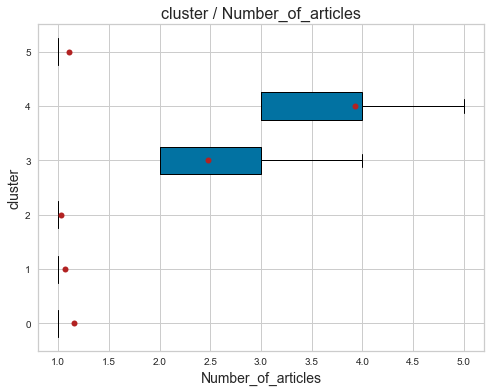

                   sum_sq       df             F  PR(>F)
C(catquali)  20482.849844      5.0  25892.794599     0.0
Residual     14384.860495  90921.0           NaN     NaN


In [102]:
boxplots(XKm_nona, 'cluster', 'Number_of_articles', tukey=0, size=(8,6), showfliers=False, sort = 1)

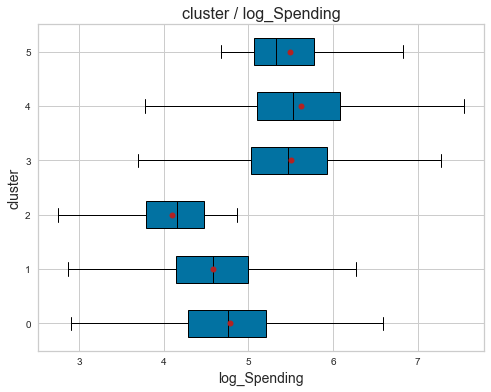

                   sum_sq       df            F  PR(>F)
C(catquali)  27869.480591      5.0  15119.33367     0.0
Residual     33518.951299  90921.0          NaN     NaN


In [103]:
boxplots(XKm_nona, 'cluster', 'log_Spending', tukey=0, size=(8,6), showfliers=False, sort = 1)

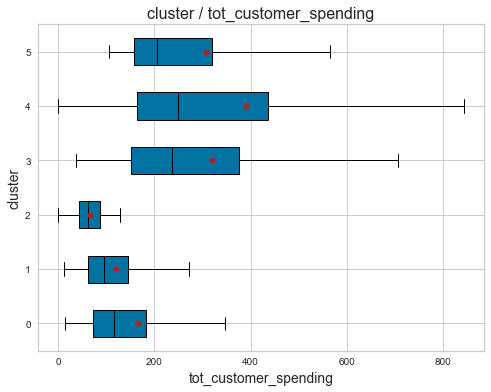

                   sum_sq       df            F  PR(>F)
C(catquali)  9.317516e+08      5.0  4522.626835     0.0
Residual     3.746309e+09  90921.0          NaN     NaN


In [104]:
boxplots(XKm_nona, 'cluster', 'tot_customer_spending', tukey=0, size=(8,6), showfliers=False, sort = 1)

<a id='extra' />

### Extra reading

In [105]:
XKm_nona['cluster'].value_counts(sort = True)

2    28577
1    23284
5    21764
0    12622
3     2707
4     1973
Name: cluster, dtype: int64

In [106]:
# 0 = Les bons / 1 = Les à oublier / 2 = Les faibles budget / 3 = Les corrects / 4 = Les dépensiers / 5 = Les insastisfaits

In [107]:
#qualiquali(XKm_nona, 'categories', 'cluster', piv=0, fig = 1, size = (15, 10), fig_norm = 0, poli = 2, heat = 1, size2 = (8, 6))

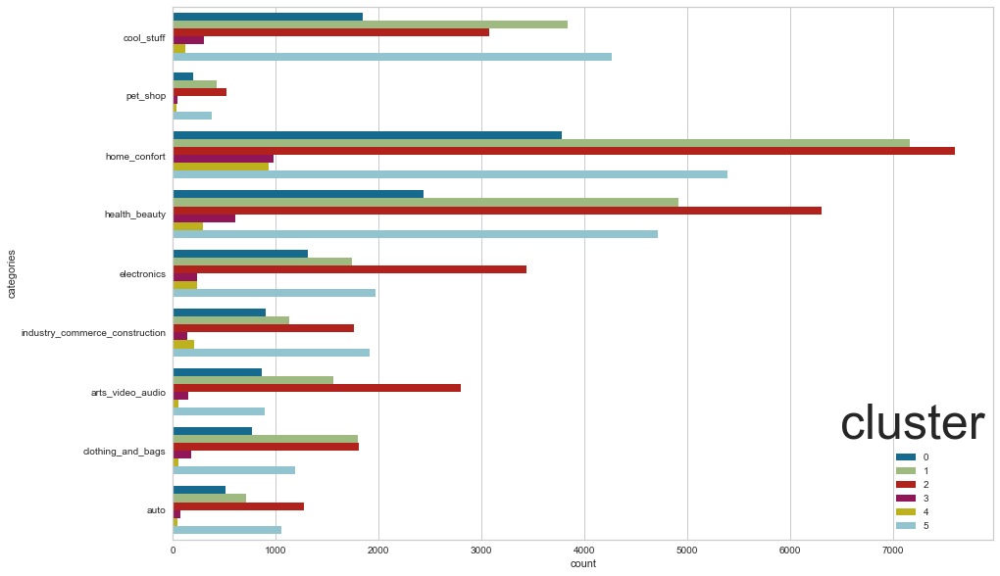

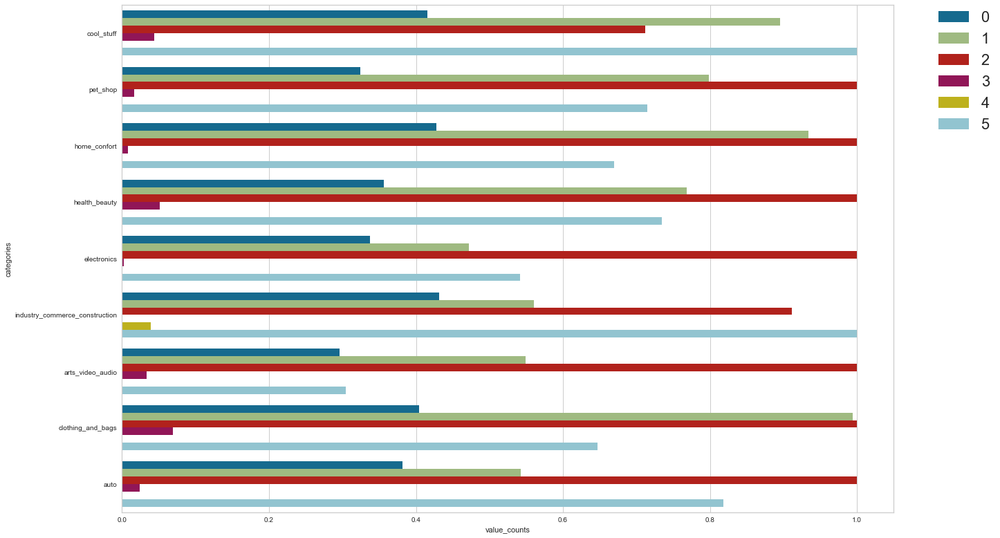

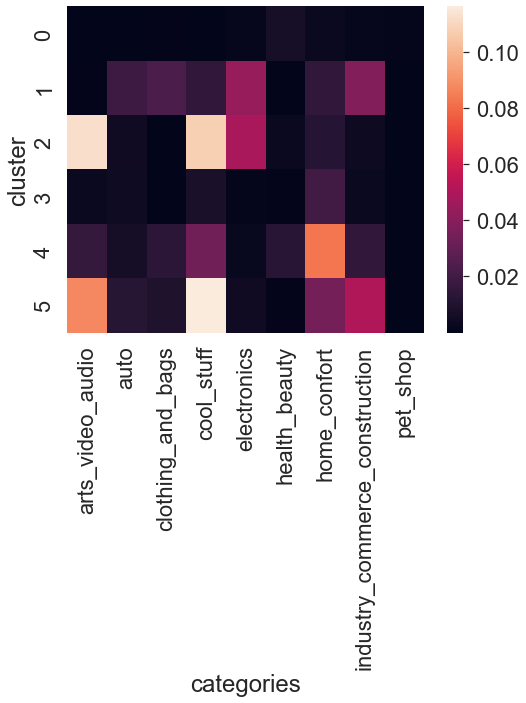

In [108]:
qualiquali(XKm_nona, 'cluster', 'categories', piv=0, fig = 1, size = (15, 10), fig_norm = 1, poli = 2, heat = 1, size2 = (8, 6))

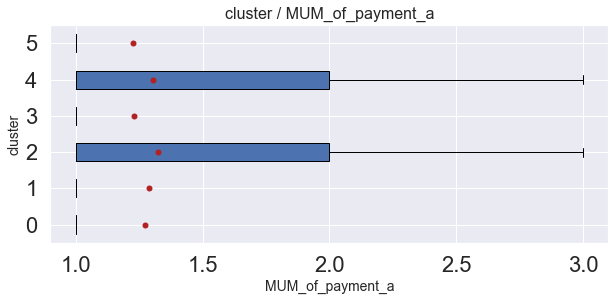

                   sum_sq       df          F        PR(>F)
C(catquali)    128.736001      5.0  78.121955  4.729706e-82
Residual     29965.471352  90921.0        NaN           NaN


In [109]:
boxplots(XKm_nona, 'cluster', 'MUM_of_payment_a', tukey=0, size=(10,4), showfliers=False, sort = 1)

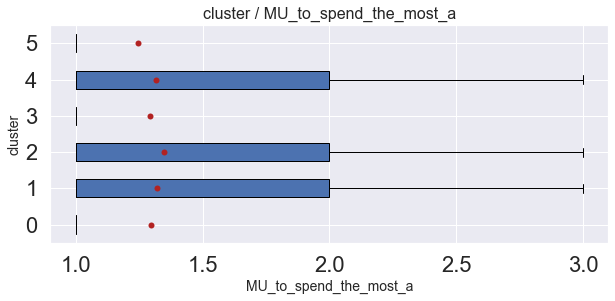

                   sum_sq       df         F        PR(>F)
C(catquali)    143.129506      5.0  78.43074  2.205758e-82
Residual     33184.636328  90921.0       NaN           NaN


In [110]:
boxplots(XKm_nona, 'cluster', 'MU_to_spend_the_most_a', tukey=0, size=(10,4), showfliers=False, sort = 1)

#### We can also look at specific groups to split them up if needed

In [111]:
depens = XKm_nona[XKm_nona['cluster'] == 4]

In [112]:
depens['categories'].value_counts(sort = True, ascending = False)

home_confort                      930
health_beauty                     294
electronics                       230
industry_commerce_construction    208
cool_stuff                        123
arts_video_audio                   57
clothing_and_bags                  56
auto                               41
pet_shop                           34
Name: categories, dtype: int64

In [113]:
depens['Cus_mean_review_score'].value_counts(sort = True, ascending = False)

5.0    820
1.0    516
4.0    326
3.0    194
2.0    109
3.5      6
2.5      1
4.5      1
Name: Cus_mean_review_score, dtype: int64

## Final groups

In [114]:
# Segmentations of clients as 1 to .
XKm_nona['fgroups'] = 0

# 0 = Les bons / 1 = Les à oublier / 2 = Les faibles budget / 3 = Les corrects / 4 = Les dépensiers / 5 = Les insastisfaits
startt = time.time()

condition = [(XKm_nona['cluster'] == 4) | (XKm_nona['Cus_mean_review_score'] > 3),
             (XKm_nona['cluster'] == 4) | (XKm_nona['Cus_mean_review_score'] < 4),
             (XKm_nona['cluster'] == 0),
             (XKm_nona['cluster'] == 3),
             (XKm_nona['cluster'] == 2),
             (XKm_nona['cluster'] == 5),
             (XKm_nona['cluster'] == 1)
]

choice = ['The satisfied spendthriftspenders', 'The unsatisfied spendthriftspenders', 'the good ones',
          'The corrects', 'Small budgets', 'The bad reviewers' , 'The one we need to forget'         
] 

XKm_nona['fgroups'] = np.select(condlist= condition, choicelist=choice, default = 0)
          
endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  0.016002893447875977 sec


----------

<a id='catmeans' />

## Kmeans "5" with added categories

In [115]:
selectedk = ['Cus_mean_review_score', 'Number_of_orders', 'Recency', 'Number_of_articles',
                                            'cool_stuff', 'pet_shop', 'home_confort', 'health_beauty',
                                            'electronics', 'industry_commerce_construction', 'arts_video_audio',
                                            'clothing_and_bags', 'auto', 'log_Spending']

X_Kad = XKm_nona.copy()[selectedk]

X_Kad_Norm = std_scale.fit_transform(X_Kad)

#### Best number of clusters

In [116]:
startt = time.time()

inertia_ad = []

K_range = range(2, 22)
for k in K_range:
    model = KMeans(n_clusters=k).fit(X_Kad_Norm)
    inertia_ad.append(model.inertia_)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  32.58672285079956 sec


Text(0, 0.5, 'Cout du modèle (Inertia_ad)')

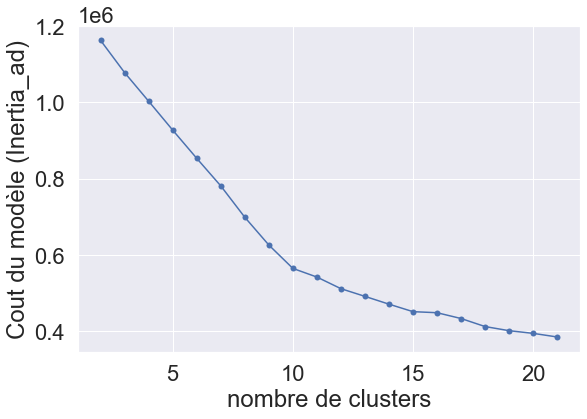

In [117]:
plt.plot(K_range, inertia_ad, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('Cout du modèle (Inertia_ad)')

In [118]:
# Best number of clusters
startt = time.time()

silhouette_ad = []

K_range = range(2, 18)
for k in K_range:
    
    cls_ad = cluster.KMeans(n_clusters=k)
    cls_ad.fit(X_Kad_Norm)
    silh_ad = metrics.silhouette_score(X_Kad_Norm, cls_ad.labels_)
    silhouette_ad.append(silh_ad)
    
    print(k)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
total time:  1201.7219333648682 sec


Text(0, 0.5, 'silhoutte')

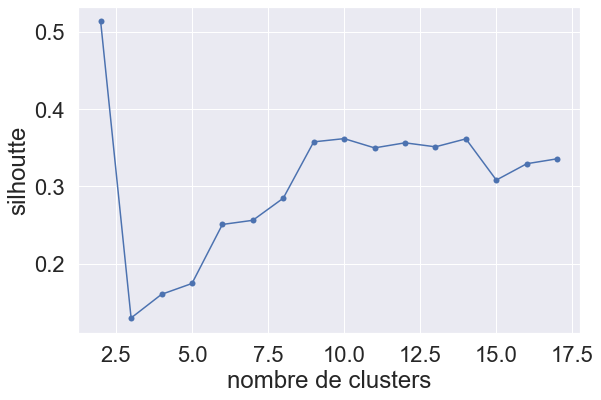

In [119]:
plt.plot(K_range, silhouette_ad, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('silhoutte')

In [120]:
# Best number of clusters with davies
startt = time.time()

davies_ad = []

K_range = range(2, 18)
for k in K_range:
    
    cls_ad = cluster.KMeans(n_clusters=k)
    cls_ad.fit(X_Kad_Norm)
    dav_ad = metrics.davies_bouldin_score(X_Kad_Norm, cls_ad.labels_)
    davies_ad.append(dav_ad)
    
    #print(k)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  21.961856603622437 sec


Text(0, 0.5, 'davies_bouldin')

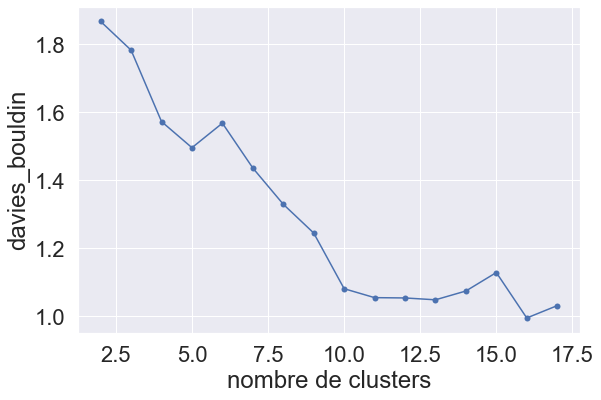

In [121]:
plt.plot(K_range, davies_ad, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('davies_bouldin')

In [122]:
model_kad = KMeans(n_clusters=10)
model_kad.fit(X_Kad_Norm)
model_kad.labels_

array([0, 0, 0, ..., 3, 4, 1])

In [123]:
X_Kad['cluster'] = model_kad.labels_

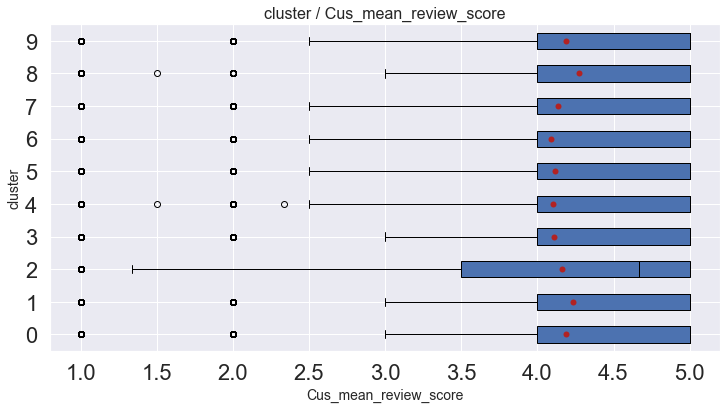

                    sum_sq       df          F        PR(>F)
C(catquali)     275.920621      9.0  18.788658  1.022300e-31
Residual     148351.174597  90917.0        NaN           NaN


In [289]:
boxplots(X_Kad, 'cluster', 'Cus_mean_review_score', tukey=0, size=(12,6), showfliers=True, sort = 1, font=12)

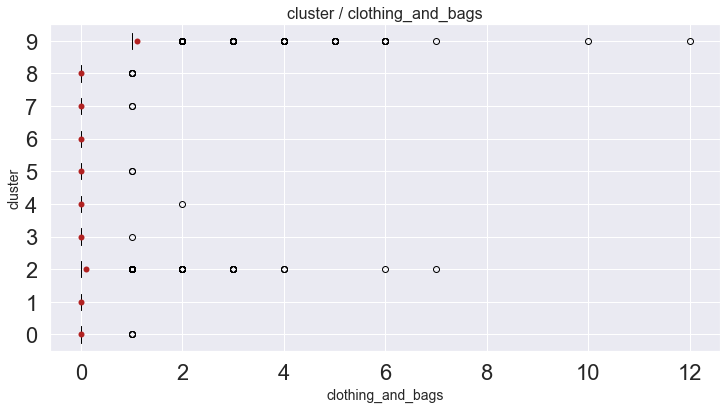

                  sum_sq       df             F  PR(>F)
C(catquali)  6514.067261      9.0  42292.380243     0.0
Residual     1555.939470  90917.0           NaN     NaN


In [124]:
boxplots(X_Kad, 'cluster', 'clothing_and_bags', tukey=0, size=(12,6), showfliers=True, sort = 1, font=12)

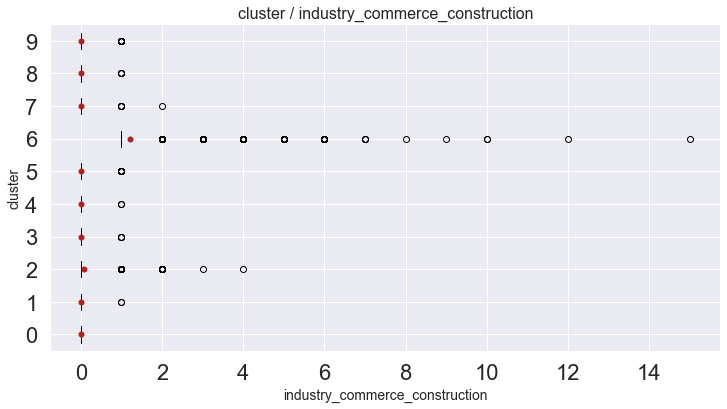

                  sum_sq       df             F  PR(>F)
C(catquali)  8057.408114      9.0  25151.544375     0.0
Residual     3236.184637  90917.0           NaN     NaN


In [125]:
boxplots(X_Kad, 'cluster', 'industry_commerce_construction', tukey=0, size=(12,6), showfliers=True, sort = 1, font=12)

In [290]:
clusters_uniqk = X_Kad['cluster'].unique()
#cluster_names = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4', 'cluster 5']
#cluster_names = ['black', 'blanchedalmond', 'blue','blueviolet', 'brown', 'burlywood', 'cadetblue']

Cluster_meansk = []
# selected = selected categories

for i in range(len(clusters_uniqk)) :
    means_ck = []
    Mean_clusterk = X_Kad[X_Kad['cluster'].isin([clusters_uniqk[i]])]
    for y in range(len(selectedk)) :
        a = Mean_clusterk[selectedk[y]]
        means_ck.append(a.mean())
    means_ck.append(i)
    Cluster_meansk.append(means_ck)

col_names = selectedk.copy()
col_names.append('cluster')

df = pd.DataFrame(Cluster_meansk, columns = col_names)

fig = px.parallel_coordinates(df, color='cluster', labels={"Cus_mean_review_score" : "Mean review score",
                                                           "Number_of_orders": "Number of orders",
                                                           "Recency" : "Last order in days", 
                                                           "Number_of_articles": "Total bought articles",
                                                           "log_Spending": "Total spending (log)"},
                              title = 'Mean values of the clusters',
                              dimensions = selectedk,
                              #color_continuous_scale=px.colors.diverging.Tealrose,
                              #color_continuous_scale=('red', 'blue', 'green', 'red', 'blue', 'green'),
                              #color_continuous_midpoint=2)
                              range_color = (1,11)
                             )
fig.show()

#### By using the different categories and selecting the best clusters, we lean towards a dedicated cluster for each categories but at the end it specifies the previous groups by splitting then and adding extra info. Last word on where to stop should be given by the marketing team